In [44]:
import pandas as pd
import numpy as np
import glob
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
import random
from os.path import join
from haversine import haversine, Unit
from matplotlib.pyplot import figure
from distfit import distfit
from numpy.random import binomial
from scipy.stats import norm
from scipy.stats import laplace

In [34]:
DAY = 11
MONTH = 7
YEAR = 2022
BUS_STOPS = "/mnt/work/datalake/trusted/busstops/year={0}/month={1:02d}/day={2:02d}".format(YEAR, MONTH, DAY)
LINES = "/mnt/work/datalake/trusted/lines/year={0}/month={1:02d}/day={2:02d}".format(YEAR, MONTH, DAY)
TIME_TABLE = "/mnt/work/datalake/trusted/timetable/year={0}/month={1:02d}/day={2:02d}".format(YEAR, MONTH, DAY)
VEHICLES = "/mnt/work/datalake/trusted/vehicles/year={0}/month={1}/day={2}".format(YEAR, MONTH, DAY)
#LINHAS = ['829', '303', '020', '506', '606', '607', '203']
LINHAS = ['020', '303']

In [35]:
parquet_files = glob.glob(join(BUS_STOPS, "*.parquet"))
data = [pd.read_parquet(f) for f in parquet_files]
bus_stops = pd.concat(data, ignore_index = True)

parquet_files = glob.glob(join(LINES, "*.parquet"))
data = [pd.read_parquet(f) for f in parquet_files]
lines = pd.concat(data, ignore_index = True)

parquet_files = glob.glob(join(TIME_TABLE, "*.parquet"))
data = [pd.read_parquet(f) for f in parquet_files]
time_table = pd.concat(data, ignore_index = True)

parquet_files = glob.glob(join(VEHICLES, "*.parquet"))
data = [pd.read_parquet(f) for f in parquet_files]
vehicles = pd.concat(data, ignore_index = True)

In [58]:
# ---------------------------------------------------------
# Limpar bus stops
# ---------------------------------------------------------
bus_stops['latitude'] = pd.to_numeric(bus_stops['latitude'])
bus_stops['longitude'] = pd.to_numeric(bus_stops['longitude'])
bus_stops['seq'] = pd.to_numeric(bus_stops['seq'])
df1 = bus_stops.query("line_code == @LINHAS").sort_values(by = ["line_code", "itinerary_id", "seq"])
df1["name_norm"] = df1["name"].str.replace("Rua", "R.", regex = False)
df1["name_norm"] = df1["name_norm"].str.extract("([\w\s.,\d]+)").apply(lambda x: x.str.strip())
df1["name_norm"] = df1["name_norm"].str.normalize("NFKD").str.encode("ascii", errors = "ignore").str.decode("utf-8")
df1["id"] = df1["name_norm"].astype('category').cat.codes
df1["next_stop_id"] = np.where((df1["line_code"] == df1["line_code"].shift(-1)) & (df1["itinerary_id"] == df1["itinerary_id"].shift(-1)), df1["id"].shift(-1), None)
df1["next_stop_name_norm"] = np.where((df1["line_code"] == df1["line_code"].shift(-1)) & (df1["itinerary_id"] == df1["itinerary_id"].shift(-1)), df1["name_norm"].shift(-1), None)
df1["next_stop_latitude"] = np.where((df1["line_code"] == df1["line_code"].shift(-1)) & (df1["itinerary_id"] == df1["itinerary_id"].shift(-1)), df1["latitude"].shift(-1), np.nan)
df1["next_stop_longitude"] = np.where((df1["line_code"] == df1["line_code"].shift(-1)) & (df1["itinerary_id"] == df1["itinerary_id"].shift(-1)), df1["longitude"].shift(-1), np.nan)
df1["next_stop_delta_s"] = df1.apply(lambda row: haversine((row["latitude"], row["longitude"]), (row["next_stop_latitude"], row["next_stop_longitude"]), unit = Unit.METERS), axis = 1)
df1 = df1.query("id != next_stop_id")

# ---------------------------------------------------------
# Calcular a velocidade média dos ônibus
# ---------------------------------------------------------
df2 = vehicles.query("line_code == @LINHAS").sort_values(by = ["line_code", "vehicle", "event_timestamp"])
df2["event_timestamp"] = pd.to_datetime(df2["event_timestamp"])
df2["last_eventtimestamp"] = np.where((df2["line_code"] == df2["line_code"].shift(1)) & (df2["vehicle"] == df2["vehicle"].shift(1)), df2["event_timestamp"].shift(1), np.datetime64('NaT'))
df2["last_latitude"] = np.where((df2["line_code"] == df2["line_code"].shift(1)) & (df2["vehicle"] == df2["vehicle"].shift(1)), df2["latitude"].shift(1), np.nan)
df2["last_longitude"] = np.where((df2["line_code"] == df2["line_code"].shift(1)) & (df2["vehicle"] == df2["vehicle"].shift(1)), df2["longitude"].shift(1), np.nan)
df2["delta_t"] = (df2["event_timestamp"] - df2["last_eventtimestamp"]).astype('timedelta64[s]')
df2["delta_s"] = df2.apply(lambda row: haversine((row["latitude"], row["longitude"]), (row["last_latitude"], row["last_longitude"]), unit = Unit.METERS), axis = 1)
df2["speed"] = 3.6 * (df2["delta_s"] / df2["delta_t"])

# ---------------------------------------------------------------
# Cortes de timestamp válidos (delta_t > 0 e delta_t < 120)
# ---------------------------------------------------------------
df2["status"] = np.where(df2["speed"] <= 10, "STOPPED", "MOVING")
df2 = df2.query("delta_t > 0 and delta_t <= 120")

# -----------------------------------------------------------------------------------------
# Cruzar a posição do ônibus com a localização dos pontos de ônibus e calcular a distância
# -----------------------------------------------------------------------------------------
dim_bus_stops = df1.groupby(by = ["id", "name_norm"]).agg({"latitude": "mean", "longitude": "mean"}).reset_index()
aux = pd.merge(df2, df1[{"line_code", "id"}].drop_duplicates(), on = ["line_code"])
aux = pd.merge(aux, dim_bus_stops, on = ["id"])
aux["distance"] = aux.apply(lambda row: haversine((row["latitude_x"], row["longitude_x"]), (row["latitude_y"], row["longitude_y"]), unit = Unit.METERS), axis = 1)

# ---------------------------------------------------------
# Computar passagem de ônibus próximo aos pontos
# ---------------------------------------------------------
df3 = aux.query("distance <= 30")[{"line_code", "vehicle", "event_timestamp", "id", "name_norm", "status"}].drop_duplicates()
df3 = df3.sort_values(by = ["line_code", "vehicle", "event_timestamp"])
df3["last_eventtimestamp"] = np.where((df3["line_code"] == df3["line_code"].shift(1)) & (df3["vehicle"] == df3["vehicle"].shift(1)), df3["event_timestamp"].shift(1), np.datetime64('NaT'))
df3["last_id"] = np.where((df3["line_code"] == df3["line_code"].shift(1)) & (df3["vehicle"] == df3["vehicle"].shift(1)), df3["id"].shift(1), np.nan)
df3["last_name_norm"] = np.where((df3["line_code"] == df3["line_code"].shift(1)) & (df3["vehicle"] == df3["vehicle"].shift(1)), df3["name_norm"].shift(1), np.nan)

df4 = aux.query("distance <= 100").sort_values(by = ["line_code", "vehicle", "event_timestamp"])
df4["last_id"] = np.where((df4["line_code"] == df4["line_code"].shift(1)) & (df4["vehicle"] == df4["vehicle"].shift(1)), df4["id"].shift(1), np.nan)
df4["last_name_norm"] = np.where((df4["line_code"] == df4["line_code"].shift(1)) & (df4["vehicle"] == df4["vehicle"].shift(1)), df4["name_norm"].shift(1), np.nan)
df4["last_status"] = np.where((df4["line_code"] == df4["line_code"].shift(1)) & (df4["vehicle"] == df4["vehicle"].shift(1)), df4["status"].shift(1), np.nan)
df4["last_eventtimestamp"] = np.where((df4["line_code"] == df4["line_code"].shift(1)) & (df4["vehicle"] == df4["vehicle"].shift(1)), df4["event_timestamp"].shift(1), np.datetime64('NaT'))
df4["next_id"] = np.where((df4["line_code"] == df4["line_code"].shift(-1)) & (df4["vehicle"] == df4["vehicle"].shift(-1)), df4["id"].shift(-1), np.nan)
df4["next_name_norm"] = np.where((df4["line_code"] == df4["line_code"].shift(-1)) & (df4["vehicle"] == df4["vehicle"].shift(-1)), df4["name_norm"].shift(-1), np.nan)
df4["next_status"] = np.where((df4["line_code"] == df4["line_code"].shift(-1)) & (df4["vehicle"] == df4["vehicle"].shift(-1)), df4["status"].shift(-1), np.nan)
df4["next_eventtimestamp"] = np.where((df4["line_code"] == df4["line_code"].shift(-1)) & (df4["vehicle"] == df4["vehicle"].shift(-1)), df4["event_timestamp"].shift(-1), np.datetime64('NaT'))
df4["delta_t"] = (df4["next_eventtimestamp"] - df4["last_eventtimestamp"]).astype('timedelta64[s]')

# ---------------------------------------------------------
# Estimar o timestamp da próxima parada
# ---------------------------------------------------------

# ---------------------------------------------------------
# Encontrar a PDF que melhor se ajusta a velocidade
# ---------------------------------------------------------
def fit_speed_pdf(line_code, vehicle):
    a = df2.query("status == 'MOVING' and line_code == @line_code and vehicle == @vehicle")["speed"]
    a = a[np.isfinite(a)]
    if a.empty:
        return np.nan
    dist = distfit()
    dist.fit_transform(a)
    return dist

# ---------------------------------------------------------
# Encontrar a PDF que melhor se ajusta ao tempo de espera
# ---------------------------------------------------------
def fit_waiting_time_pdf(line_code, vehicle):
    a = df4.query("last_status == 'MOVING' and status == 'STOPPED' and next_status == 'MOVING' and id == last_id and id == next_id and delta_t and line_code == @line_code and vehicle == @vehicle")["delta_t"]
    a = a[np.isfinite(a)]
    if a.empty:
        return np.nan    
    dist = distfit()
    dist.fit_transform(a)
    return dist

# ---------------------------------------------------------
# Calcular a probabilidade a priori de haver paradas
# ---------------------------------------------------------
def calculate_apriori_bus_stop(line_code, vehicle):
    a = df3.query("line_code == @line_code and vehicle == @vehicle")
    if a.empty:
        return np.nan
    a = a.groupby(by = ["line_code", "vehicle", "status"]).agg({"id": "count"}).reset_index()
    a["%"] = a["id"] / a.groupby(by = ["line_code", "vehicle"])["id"].transform("sum")
    return a.query("status == 'STOPPED'")["%"].iloc[0]

# ---------------------------------------------------------
# Estimar o intervalo de tempo para a próxima parada
# ---------------------------------------------------------
def estimate_next_delta_t(next_stop_delta_s, speed_pdf, waiting_time_pdf, apriori_bus_stop, status = None):
    if status == "STOPPED":
        b = 1
    else:
        b = binomial(1, apriori_bus_stop)
    return 3.6 * next_stop_delta_s / speed_pdf.generate(1)[0] + b * waiting_time_pdf.generate(1)[0]

vehicle_pdfs = df2[{"line_code", "vehicle"}].drop_duplicates()
vehicle_pdfs["speed_pdf"] = vehicle_pdfs.apply(lambda row: fit_speed_pdf(row["line_code"], row["vehicle"]), axis = 1)
vehicle_pdfs["waiting_time_pdf"] = vehicle_pdfs.apply(lambda row: fit_waiting_time_pdf(row["line_code"], row["vehicle"]), axis = 1)
vehicle_pdfs["apriori_bus_stop"] = vehicle_pdfs.apply(lambda row: calculate_apriori_bus_stop(row["line_code"], row["vehicle"]), axis = 1)

# ---------------------------------------------------------
# Procurar o itinerário do ônibus (sentido da rota)
# ---------------------------------------------------------
def procurar_itinerario(destino, origem):
    # Destino x Origem - determina o itinerário
    if np.isnan(origem) or origem == destino: # TODO: verificar esses casos (onde id == last_id)
        return np.nan
    aux = pd.merge(df1.query("id == @destino"), df1.query("id == @origem"), on = ["itinerary_id", "line_code"]).query("seq_x > seq_y")["itinerary_id"]
    if aux.empty:
        return np.nan
    return aux.iloc[0]

df3["itinerary_id"] = df3.apply(lambda row: procurar_itinerario(row["id"], row["last_id"]), axis = 1)

# ---------------------------------------------------------
# Passar filtro de itinerario para atenuar ruído
# ---------------------------------------------------------
df9 = df3.groupby(by = ["line_code", "vehicle", "itinerary_id"]).agg({"id": "count"}).reset_index()
df9["%"] = df9["id"] / df9.groupby(by = ["line_code", "vehicle"])["id"].transform("sum")
counts, bins = np.histogram(df9["%"])
corte = bins[len(bins) - 2]

def filtrar_itinerario(line_code, vehicle, valor_original, corte):
    a = df9.query("line_code == @line_code and vehicle == @vehicle").sort_values("%", ascending = False).iloc[0]
    if (a["%"] >= corte):
        return a["itinerary_id"]
    else:
        return valor_original

df3["itinerary_id"] = df3.apply(lambda row: filtrar_itinerario(row["line_code"], row["vehicle"], row["itinerary_id"], corte), axis = 1)
df3 = pd.merge(df3, df1, on = ["line_code", "id", "itinerary_id"], how = "inner")
df3 = pd.merge(df3, vehicle_pdfs[{"line_code", "vehicle", "speed_pdf", "waiting_time_pdf", "apriori_bus_stop"}], on = ["line_code", "vehicle"], how = "inner")
df3 = df3.query("speed_pdf.notna() & waiting_time_pdf.notna()")
df3["estimated_next_delta_t"] = df3.apply(lambda row: estimate_next_delta_t(row["next_stop_delta_s"], row["speed_pdf"], row["waiting_time_pdf"], row["apriori_bus_stop"]), axis = 1)
df3["estimated_next_eventtimestamp"] = df3["event_timestamp"] + pd.to_timedelta(df3["estimated_next_delta_t"], unit = 's')
df3.drop(["name_norm_y", "name", "number", "line_way", "type"], axis = 1, inplace = True)
df3.rename(columns = {"name_norm_x": "name_norm"}, inplace = True)

# ---------------------------------------------------------
# Computar a diferença entre o real e o estimado
# ---------------------------------------------------------
df5 = df3[{"line_code", "event_timestamp", "name_norm", "id", "next_stop_id", "estimated_next_eventtimestamp", "itinerary_id", "vehicle", "next_stop_delta_s"}].sort_values(by = ["line_code", "vehicle", "event_timestamp"])
df5["last_next_stop_id"] = np.where((df5["line_code"] == df5["line_code"].shift(1)) & (df5["itinerary_id"] == df5["itinerary_id"].shift(1)), df5["next_stop_id"].shift(1), None)
df5["last_event_timestamp"] = np.where((df5["line_code"] == df5["line_code"].shift(1)) & (df5["itinerary_id"] == df5["itinerary_id"].shift(1)), df5["event_timestamp"].shift(1), None)
df5["last_estimated_next_eventtimestamp"] = np.where((df5["line_code"] == df5["line_code"].shift(1)) & (df5["itinerary_id"] == df5["itinerary_id"].shift(1)), df5["estimated_next_eventtimestamp"].shift(1), None)
df5["last_id"] = np.where((df5["line_code"] == df5["line_code"].shift(1)) & (df5["itinerary_id"] == df5["itinerary_id"].shift(1)), df5["id"].shift(1), None)
df5["last_name_norm"] = np.where((df5["line_code"] == df5["line_code"].shift(1)) & (df5["itinerary_id"] == df5["itinerary_id"].shift(1)), df5["name_norm"].shift(1), None)
df5["last_estimated_next_eventtimestamp"] = pd.to_datetime(df5["last_estimated_next_eventtimestamp"])
df5["last_event_timestamp"] = pd.to_datetime(df5["last_event_timestamp"])
df5["last_next_stop_delta_s"] = np.where((df5["line_code"] == df5["line_code"].shift(1)) & (df5["itinerary_id"] == df5["itinerary_id"].shift(1)), df5["next_stop_delta_s"].shift(1), None)
df5["delta_t"] = (df5["event_timestamp"] - df5["last_estimated_next_eventtimestamp"]).astype('timedelta64[s]')

[distfit] >fit..
[distfit] >transform..
[distfit] >[norm      ] [0.00 sec] [RSS: 0.00190396] [loc=30.200 scale=11.163]
[distfit] >[expon     ] [0.00 sec] [RSS: 0.00844882] [loc=10.003 scale=20.196]
[distfit] >[pareto    ] [0.02 sec] [RSS: 0.0208936] [loc=-0.019 scale=10.022]
[distfit] >[dweibull  ] [0.01 sec] [RSS: 0.00253327] [loc=30.275 scale=10.015]
[distfit] >[t         ] [0.04 sec] [RSS: 0.0019042] [loc=30.199 scale=11.163]
[distfit] >[genextreme] [0.07 sec] [RSS: 0.0018357] [loc=26.124 scale=10.829]
[distfit] >[gamma     ] [0.04 sec] [RSS: 0.00193475] [loc=-72.343 scale=1.215]
[distfit] >[lognorm   ] [0.08 sec] [RSS: 0.00195057] [loc=-103.208 scale=132.941]
[distfit] >[beta      ] [0.02 sec] [RSS: 0.00182813] [loc=9.576 scale=48.900]
[distfit] >[uniform   ] [0.00 sec] [RSS: 0.00516779] [loc=10.003 scale=48.101]
[distfit] >[loggamma  ] [0.05 sec] [RSS: 0.00186626] [loc=-2026.267 scale=310.164]
[distfit] >Compute confidence interval [parametric]
[distfit] >fit..
[distfit] >transfor

[distfit] >[gamma     ] [0.05 sec] [RSS: 0.00125546] [loc=-17.601 scale=2.239]
[distfit] >[lognorm   ] [0.08 sec] [RSS: 0.00124033] [loc=-57.107 scale=85.944]
[distfit] >[beta      ] [0.02 sec] [RSS: 0.000788285] [loc=9.392 scale=48.835]
[distfit] >[uniform   ] [0.00 sec] [RSS: 0.00647519] [loc=10.017 scale=46.945]
[distfit] >[loggamma  ] [0.05 sec] [RSS: 0.00118579] [loc=-3255.487 scale=437.694]
[distfit] >Compute confidence interval [parametric]
[distfit] >fit..
[distfit] >transform..
[distfit] >[norm      ] [0.00 sec] [RSS: 0.00105547] [loc=31.028 scale=10.982]
[distfit] >[expon     ] [0.00 sec] [RSS: 0.00903799] [loc=10.088 scale=20.941]
[distfit] >[pareto    ] [0.03 sec] [RSS: 0.0223415] [loc=-0.021 scale=10.109]
[distfit] >[dweibull  ] [0.02 sec] [RSS: 0.00164844] [loc=31.340 scale=9.885]
[distfit] >[t         ] [0.06 sec] [RSS: 0.00105477] [loc=31.026 scale=10.983]
[distfit] >[genextreme] [0.19 sec] [RSS: 0.000934754] [loc=26.917 scale=10.534]
[distfit] >[gamma     ] [0.05 sec] 

[distfit] >[lognorm   ] [0.08 sec] [RSS: 0.0166431] [loc=-563.453 scale=599.215]
[distfit] >[beta      ] [0.04 sec] [RSS: 0.0151442] [loc=9.896 scale=50.149]
[distfit] >[uniform   ] [0.00 sec] [RSS: 0.0150251] [loc=11.213 scale=48.833]
[distfit] >[loggamma  ] [0.04 sec] [RSS: 0.016656] [loc=-2402.354 scale=372.179]
[distfit] >Compute confidence interval [parametric]
[distfit] >fit..
[distfit] >transform..
[distfit] >[norm      ] [0.00 sec] [RSS: 0.00113913] [loc=33.741 scale=12.427]
[distfit] >[expon     ] [0.00 sec] [RSS: 0.00739802] [loc=10.016 scale=23.725]
[distfit] >[pareto    ] [0.03 sec] [RSS: 0.0192965] [loc=-0.023 scale=10.040]
[distfit] >[dweibull  ] [0.01 sec] [RSS: 0.0015004] [loc=33.438 scale=11.253]
[distfit] >[t         ] [0.05 sec] [RSS: 0.00113933] [loc=33.740 scale=12.426]
[distfit] >[genextreme] [0.13 sec] [RSS: 0.00103383] [loc=29.356 scale=12.194]
[distfit] >[gamma     ] [0.05 sec] [RSS: 0.00110858] [loc=-123.864 scale=0.978]
[distfit] >[lognorm   ] [0.10 sec] [RSS

[distfit] >[genextreme] [0.10 sec] [RSS: 0.00264323] [loc=28.143 scale=12.568]
[distfit] >[gamma     ] [0.04 sec] [RSS: 0.00269887] [loc=-67.326 scale=1.666]
[distfit] >[lognorm   ] [0.07 sec] [RSS: 0.0027097] [loc=-77.603 scale=109.548]
[distfit] >[beta      ] [0.01 sec] [RSS: 0.00164126] [loc=10.048 scale=50.625]
[distfit] >[uniform   ] [0.00 sec] [RSS: 0.00308065] [loc=10.093 scale=50.416]
[distfit] >[loggamma  ] [0.04 sec] [RSS: 0.0027769] [loc=-3533.587 scale=490.423]
[distfit] >Compute confidence interval [parametric]
[distfit] >fit..
[distfit] >transform..
[distfit] >[norm      ] [0.00 sec] [RSS: 0.00247445] [loc=33.494 scale=12.545]
[distfit] >[expon     ] [0.00 sec] [RSS: 0.00815348] [loc=10.134 scale=23.361]
[distfit] >[pareto    ] [0.02 sec] [RSS: 0.0198615] [loc=-0.022 scale=10.156]
[distfit] >[dweibull  ] [0.01 sec] [RSS: 0.00289421] [loc=33.746 scale=11.516]
[distfit] >[t         ] [0.05 sec] [RSS: 0.00247435] [loc=33.494 scale=12.546]
[distfit] >[genextreme] [0.10 sec] [

[distfit] >[genextreme] [0.09 sec] [RSS: 0.00101822] [loc=29.706 scale=12.728]
[distfit] >[gamma     ] [0.05 sec] [RSS: 0.00111879] [loc=-211.049 scale=0.677]
[distfit] >[lognorm   ] [0.09 sec] [RSS: 0.00112309] [loc=-188.214 scale=222.013]
[distfit] >[beta      ] [0.04 sec] [RSS: 0.00070545] [loc=9.695 scale=55.605]
[distfit] >[uniform   ] [0.00 sec] [RSS: 0.00310743] [loc=10.063 scale=55.052]
[distfit] >[loggamma  ] [0.05 sec] [RSS: 0.00111732] [loc=-2947.314 scale=426.496]
[distfit] >Compute confidence interval [parametric]
[distfit] >fit..
[distfit] >transform..
[distfit] >[norm      ] [0.00 sec] [RSS: 0.00333762] [loc=32.411 scale=13.420]
[distfit] >[expon     ] [0.00 sec] [RSS: 0.00566003] [loc=10.043 scale=22.368]
[distfit] >[pareto    ] [0.02 sec] [RSS: 0.0149361] [loc=-0.019 scale=10.062]
[distfit] >[dweibull  ] [0.01 sec] [RSS: 0.00408323] [loc=32.205 scale=12.249]
[distfit] >[t         ] [0.06 sec] [RSS: 0.00333991] [loc=32.408 scale=13.414]
[distfit] >[genextreme] [0.08 sec

[distfit] >[pareto    ] [0.05 sec] [RSS: 0.0206642] [loc=-0.022 scale=10.034]
[distfit] >[dweibull  ] [0.03 sec] [RSS: 0.0017986] [loc=33.253 scale=10.919]
[distfit] >[t         ] [0.07 sec] [RSS: 0.00118294] [loc=33.381 scale=12.023]
[distfit] >[genextreme] [0.25 sec] [RSS: 0.00104981] [loc=29.476 scale=12.158]
[distfit] >[gamma     ] [0.03 sec] [RSS: 0.00118288] [loc=-2943.475 scale=0.049]
[distfit] >[lognorm   ] [0.18 sec] [RSS: 0.00118613] [loc=-421.614 scale=454.820]
[distfit] >[beta      ] [0.05 sec] [RSS: 0.000731109] [loc=9.385 scale=51.537]
[distfit] >[uniform   ] [0.00 sec] [RSS: 0.0032521] [loc=10.012 scale=50.825]
[distfit] >[loggamma  ] [0.06 sec] [RSS: 0.0011805] [loc=-2154.197 scale=330.247]
[distfit] >Compute confidence interval [parametric]
[distfit] >fit..
[distfit] >transform..
[distfit] >[norm      ] [0.00 sec] [RSS: 0.00179587] [loc=32.917 scale=11.589]
[distfit] >[expon     ] [0.00 sec] [RSS: 0.00924074] [loc=10.001 scale=22.917]
[distfit] >[pareto    ] [0.03 sec]

[distfit] >[genextreme] [0.08 sec] [RSS: 0.000375884] [loc=23.227 scale=8.052]
[distfit] >[gamma     ] [0.04 sec] [RSS: 0.000970772] [loc=15.000 scale=132.183]
[distfit] >[lognorm   ] [0.03 sec] [RSS: 0.000285392] [loc=14.078 scale=13.076]
[distfit] >[beta      ] [0.07 sec] [RSS: 0.000423845] [loc=15.000 scale=7822.365]
[distfit] >[uniform   ] [0.00 sec] [RSS: 0.00258284] [loc=15.000 scale=480.000]
[distfit] >[loggamma  ] [0.04 sec] [RSS: 0.00206984] [loc=-25998.521 scale=3443.482]
[distfit] >Compute confidence interval [parametric]
[distfit] >fit..
[distfit] >transform..
[distfit] >[norm      ] [0.00 sec] [RSS: 0.00186616] [loc=38.053 scale=62.822]
[distfit] >[expon     ] [0.00 sec] [RSS: 0.00034426] [loc=15.000 scale=23.053]
[distfit] >[pareto    ] [0.02 sec] [RSS: 7.99882e-05] [loc=-0.032 scale=15.032]
[distfit] >[dweibull  ] [0.05 sec] [RSS: 0.000467794] [loc=20.000 scale=19.039]
[distfit] >[t         ] [0.03 sec] [RSS: 0.000414616] [loc=22.247 scale=4.657]
[distfit] >[genextreme] 

[distfit] >fit..
[distfit] >transform..
[distfit] >[norm      ] [0.00 sec] [RSS: 0.00297484] [loc=32.588 scale=34.322]
[distfit] >[expon     ] [0.00 sec] [RSS: 0.00217861] [loc=10.000 scale=22.588]
[distfit] >[pareto    ] [0.02 sec] [RSS: 0.00389033] [loc=-0.016 scale=10.016]
[distfit] >[dweibull  ] [0.04 sec] [RSS: 0.00146184] [loc=25.000 scale=16.310]
[distfit] >[t         ] [0.03 sec] [RSS: 0.000302824] [loc=24.023 scale=5.049]
[distfit] >[genextreme] [0.08 sec] [RSS: 0.000780496] [loc=22.520 scale=8.102]
[distfit] >[gamma     ] [0.04 sec] [RSS: 0.00483158] [loc=10.000 scale=6.290]
[distfit] >[lognorm   ] [0.01 sec] [RSS: 0.000951435] [loc=8.187 scale=18.038]
[distfit] >[beta      ] [0.06 sec] [RSS: 0.00148529] [loc=9.785 scale=282790492918.081]
[distfit] >[uniform   ] [0.00 sec] [RSS: 0.00461132] [loc=10.000 scale=355.000]
[distfit] >[loggamma  ] [0.04 sec] [RSS: 0.00307983] [loc=-18385.590 scale=2248.781]
[distfit] >Compute confidence interval [parametric]
[distfit] >fit..
[distfi

[distfit] >[genextreme] [0.13 sec] [RSS: 0.0859899] [loc=25.000 scale=0.000]
[distfit] >[gamma     ] [0.03 sec] [RSS: 0.0506867] [loc=25.000 scale=10.211]
[distfit] >[lognorm   ] [0.04 sec] [RSS: 0.0525721] [loc=25.000 scale=0.009]
[distfit] >[beta      ] [0.06 sec] [RSS: 0.0470023] [loc=25.000 scale=69.481]
[distfit] >[uniform   ] [0.00 sec] [RSS: 0.074159] [loc=25.000 scale=65.000]
[distfit] >[loggamma  ] [0.04 sec] [RSS: 0.0735709] [loc=-5223.522 scale=728.150]
[distfit] >Compute confidence interval [parametric]
[distfit] >fit..
[distfit] >transform..
[distfit] >[norm      ] [0.00 sec] [RSS: 0.00217925] [loc=49.095 scale=49.633]
[distfit] >[expon     ] [0.00 sec] [RSS: 0.000393159] [loc=25.000 scale=24.095]
[distfit] >[pareto    ] [0.02 sec] [RSS: 4.65863e-05] [loc=-0.068 scale=25.068]
[distfit] >[dweibull  ] [0.04 sec] [RSS: 0.0010093] [loc=35.000 scale=16.221]
[distfit] >[t         ] [0.03 sec] [RSS: 0.000613965] [loc=34.966 scale=8.629]
[distfit] >[genextreme] [0.08 sec] [RSS: 3.

[distfit] >[pareto    ] [0.02 sec] [RSS: 0.00191205] [loc=-0.051 scale=20.051]
[distfit] >[dweibull  ] [0.02 sec] [RSS: 0.000489773] [loc=30.000 scale=32.925]
[distfit] >[t         ] [0.04 sec] [RSS: 0.00349813] [loc=30.000 scale=0.000]
[distfit] >[genextreme] [0.07 sec] [RSS: 0.000412435] [loc=32.347 scale=9.617]
[distfit] >[gamma     ] [0.03 sec] [RSS: 0.00124303] [loc=19.978 scale=26.251]
[distfit] >[lognorm   ] [0.01 sec] [RSS: 0.000675424] [loc=19.169 scale=18.456]
[distfit] >[beta      ] [0.07 sec] [RSS: 0.00133453] [loc=20.000 scale=2342.474]
[distfit] >[uniform   ] [0.00 sec] [RSS: 0.00399546] [loc=20.000 scale=315.000]
[distfit] >[loggamma  ] [0.04 sec] [RSS: 0.00287143] [loc=-19664.340 scale=2468.657]
[distfit] >Compute confidence interval [parametric]
[distfit] >fit..
[distfit] >transform..
[distfit] >[norm      ] [0.00 sec] [RSS: 0.00182179] [loc=45.921 scale=42.476]
[distfit] >[expon     ] [0.00 sec] [RSS: 0.00147507] [loc=15.000 scale=30.921]
[distfit] >[pareto    ] [0.02

[distfit] >[pareto    ] [0.01 sec] [RSS: 0.000116292] [loc=-0.070 scale=25.070]
[distfit] >[dweibull  ] [0.04 sec] [RSS: 0.000359017] [loc=30.000 scale=33.189]
[distfit] >[t         ] [0.02 sec] [RSS: 0.000175343] [loc=32.207 scale=5.142]
[distfit] >[genextreme] [0.05 sec] [RSS: 6.10405e-05] [loc=32.594 scale=9.192]
[distfit] >[gamma     ] [0.03 sec] [RSS: 0.00216722] [loc=25.000 scale=4.341]
[distfit] >[lognorm   ] [0.03 sec] [RSS: 0.000104619] [loc=24.218 scale=12.661]
[distfit] >[beta      ] [0.06 sec] [RSS: 0.000215676] [loc=25.000 scale=6200.335]
[distfit] >[uniform   ] [0.00 sec] [RSS: 0.00218895] [loc=25.000 scale=635.000]
[distfit] >[loggamma  ] [0.04 sec] [RSS: 0.0017858] [loc=-32814.144 scale=4157.505]
[distfit] >Compute confidence interval [parametric]
[distfit] >fit..
[distfit] >transform..
[distfit] >[norm      ] [0.00 sec] [RSS: 0.00125385] [loc=55.269 scale=74.148]
[distfit] >[expon     ] [0.00 sec] [RSS: 0.00082857] [loc=10.000 scale=45.269]
[distfit] >[pareto    ] [0.0

[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted 

[distfit] >Generate 1 t distributed samples with fitted params (1.1968291367052846, 23.427541635256418, 4.6864473299109335).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4749620457612609, 1.8351877475521756, 9.773858914181815, 49.456401349949786).
[distfit] >Generate 1 t distributed samples with fitted params (1.1968291367052846, 23.427541635256418, 4.6864473299109335).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4749620457612609, 1.8351877475521756, 9.773858914181815, 49.456401349949786).
[distfit] >Generate 1 t distributed samples with fitted params (1.1968291367052846, 23.427541635256418, 4.6864473299109335).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4749620457612609, 1.8351877475521756, 9.773858914181815, 49.456401349949786).
[distfit] >Generate 1 t distributed samples with fitted params (1.1968291367052846, 23.427541635256418, 4.6864473299109335).
[distfit] >Generate 1 beta distributed samples with fitted 

[distfit] >Generate 1 t distributed samples with fitted params (0.9945494035986433, 24.08170785737711, 5.45247639017803).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8011125398684387, 2.467625161199025, 8.897475630878647, 49.46635022122753).
[distfit] >Generate 1 t distributed samples with fitted params (0.9945494035986433, 24.08170785737711, 5.45247639017803).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8011125398684387, 2.467625161199025, 8.897475630878647, 49.46635022122753).
[distfit] >Generate 1 t distributed samples with fitted params (0.9945494035986433, 24.08170785737711, 5.45247639017803).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8011125398684387, 2.467625161199025, 8.897475630878647, 49.46635022122753).
[distfit] >Generate 1 t distributed samples with fitted params (0.9945494035986433, 24.08170785737711, 5.45247639017803).
[distfit] >Generate 1 beta distributed samples with fitted params (1.80111253

[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm 

[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm 

[distfit] >Generate 1 t distributed samples with fitted params (1.2768316109756146, 23.43979200349179, 4.2640091593245675).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4964841340753037, 1.950407179376171, 9.74564708494363, 48.24017010485413).
[distfit] >Generate 1 t distributed samples with fitted params (1.2768316109756146, 23.43979200349179, 4.2640091593245675).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4964841340753037, 1.950407179376171, 9.74564708494363, 48.24017010485413).
[distfit] >Generate 1 t distributed samples with fitted params (1.2768316109756146, 23.43979200349179, 4.2640091593245675).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4964841340753037, 1.950407179376171, 9.74564708494363, 48.24017010485413).
[distfit] >Generate 1 t distributed samples with fitted params (1.2768316109756146, 23.43979200349179, 4.2640091593245675).
[distfit] >Generate 1 beta distributed samples with fitted params (1.496

[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.

[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibu

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibu

[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitt

[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitt

[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.23863983852

[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.877

[distfit] >Generate 1 t distributed samples with fitted params (1.1041391742182278, 23.711801360648366, 5.487302138077467).
[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with fitted params (1.1041391742182278, 23.711801360648366, 5.487302138077467).
[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with fitted params (1.1041391742182278, 23.711801360648366, 5.487302138077467).
[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with fitted params (1.1041391742182278, 23.711801360648366, 5.487302138077467).
[distfit] >Generate 1 beta distributed samples with fitted params (1.

[distfit] >Generate 1 t distributed samples with fitted params (1.1041391742182278, 23.711801360648366, 5.487302138077467).
[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with fitted params (1.1041391742182278, 23.711801360648366, 5.487302138077467).
[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with fitted params (1.1041391742182278, 23.711801360648366, 5.487302138077467).
[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with fitted params (1.1041391742182278, 23.711801360648366, 5.487302138077467).
[distfit] >Generate 1 beta distributed samples with fitted params (1.

[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.17788250515039172, 35.282590230192646, 12.482122994427622).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6296479393640402, 2.1133182153398025, 9.204536359610362, 53.153469863206745).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.17788250515039172, 35.282590230192646, 12.482122994427622).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6296479393640402, 2.1133182153398025, 9.204536359610362, 53.153469863206745).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.17788250515039172, 35.282590230192646, 12.482122994427622).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6296479393640402, 2.1133182153398025, 9.204536359610362, 53.153469863206745).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.17788250515039172, 35.282590230192646, 12.482122994427622).
[distfit] >Gene

[distfit] >Generate 1 beta distributed samples with fitted params (1.3795616388205174, 1.9179547735393307, 9.75360406765772, 55.69475751164332).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.306777758588774, 33.521270550163294, 12.399248414630986).
[distfit] >Generate 1 beta distributed samples with fitted params (1.3795616388205174, 1.9179547735393307, 9.75360406765772, 55.69475751164332).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.306777758588774, 33.521270550163294, 12.399248414630986).
[distfit] >Generate 1 beta distributed samples with fitted params (1.3795616388205174, 1.9179547735393307, 9.75360406765772, 55.69475751164332).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.306777758588774, 33.521270550163294, 12.399248414630986).
[distfit] >Generate 1 beta distributed samples with fitted params (1.3795616388205174, 1.9179547735393307, 9.75360406765772, 55.69475751164332).
[distfit] >Generat

[distfit] >Generate 1 beta distributed samples with fitted params (1.632712375550942, 2.250163796934464, 9.426327155513674, 54.39212201390248).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.6449148801933008, 32.40804864460938, 8.731311362343153).
[distfit] >Generate 1 beta distributed samples with fitted params (1.632712375550942, 2.250163796934464, 9.426327155513674, 54.39212201390248).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.6449148801933008, 32.40804864460938, 8.731311362343153).
[distfit] >Generate 1 beta distributed samples with fitted params (1.632712375550942, 2.250163796934464, 9.426327155513674, 54.39212201390248).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.6449148801933008, 32.40804864460938, 8.731311362343153).
[distfit] >Generate 1 beta distributed samples with fitted params (1.632712375550942, 2.250163796934464, 9.426327155513674, 54.39212201390248).
[distfit] >Generate 1 gen

[distfit] >Generate 1 beta distributed samples with fitted params (1.2202825561707185, 1.5270589157561916, 10.047669135645771, 50.62546096385053).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.36893928242731044, 34.42578905729294, 11.040775672815547).
[distfit] >Generate 1 beta distributed samples with fitted params (1.2202825561707185, 1.5270589157561916, 10.047669135645771, 50.62546096385053).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.36893928242731044, 34.42578905729294, 11.040775672815547).
[distfit] >Generate 1 beta distributed samples with fitted params (1.2202825561707185, 1.5270589157561916, 10.047669135645771, 50.62546096385053).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.36893928242731044, 34.42578905729294, 11.040775672815547).
[distfit] >Generate 1 beta distributed samples with fitted params (1.2202825561707185, 1.5270589157561916, 10.047669135645771, 50.62546096385053).
[distfi

[distfit] >Generate 1 t distributed samples with fitted params (0.8499783980359428, 31.97050977801072, 5.786965289174963).
[distfit] >Generate 1 beta distributed samples with fitted params (2.0215262664475055, 3.1080949207259643, 8.428836835369598, 64.83334978113362).
[distfit] >Generate 1 t distributed samples with fitted params (0.8499783980359428, 31.97050977801072, 5.786965289174963).
[distfit] >Generate 1 beta distributed samples with fitted params (2.0215262664475055, 3.1080949207259643, 8.428836835369598, 64.83334978113362).
[distfit] >Generate 1 t distributed samples with fitted params (0.8499783980359428, 31.97050977801072, 5.786965289174963).
[distfit] >Generate 1 beta distributed samples with fitted params (2.0215262664475055, 3.1080949207259643, 8.428836835369598, 64.83334978113362).
[distfit] >Generate 1 t distributed samples with fitted params (0.8499783980359428, 31.97050977801072, 5.786965289174963).
[distfit] >Generate 1 beta distributed samples with fitted params (2.0

[distfit] >Generate 1 beta distributed samples with fitted params (1.606864185782717, 2.755160373200182, 9.55618644038732, 59.56652338614626).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.7157741500488094, 34.999999999999986, 17.90776914339095).
[distfit] >Generate 1 beta distributed samples with fitted params (1.606864185782717, 2.755160373200182, 9.55618644038732, 59.56652338614626).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.7157741500488094, 34.999999999999986, 17.90776914339095).
[distfit] >Generate 1 beta distributed samples with fitted params (1.606864185782717, 2.755160373200182, 9.55618644038732, 59.56652338614626).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.7157741500488094, 34.999999999999986, 17.90776914339095).
[distfit] >Generate 1 beta distributed samples with fitted params (1.606864185782717, 2.755160373200182, 9.55618644038732, 59.56652338614626).
[distfit] >Generate 1 dweibull dist

[distfit] >Generate 1 beta distributed samples with fitted params (1.4502419035644152, 2.1485143925896435, 9.801350516058445, 56.70878019997732).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.29600176052887284, 33.239885160456566, 11.23387312700148).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4502419035644152, 2.1485143925896435, 9.801350516058445, 56.70878019997732).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.29600176052887284, 33.239885160456566, 11.23387312700148).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4502419035644152, 2.1485143925896435, 9.801350516058445, 56.70878019997732).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.29600176052887284, 33.239885160456566, 11.23387312700148).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4502419035644152, 2.1485143925896435, 9.801350516058445, 56.70878019997732).
[distfit] >

[distfit] >Generate 1 t distributed samples with fitted params (0.7216540468393483, 29.92660791994855, 4.0209787046880034).
[distfit] >Generate 1 beta distributed samples with fitted params (1.518396447547043, 1.966718666367492, 9.694575004841958, 55.604591753963504).
[distfit] >Generate 1 t distributed samples with fitted params (0.7216540468393483, 29.92660791994855, 4.0209787046880034).
[distfit] >Generate 1 beta distributed samples with fitted params (1.518396447547043, 1.966718666367492, 9.694575004841958, 55.604591753963504).
[distfit] >Generate 1 t distributed samples with fitted params (0.7216540468393483, 29.92660791994855, 4.0209787046880034).
[distfit] >Generate 1 beta distributed samples with fitted params (1.518396447547043, 1.966718666367492, 9.694575004841958, 55.604591753963504).
[distfit] >Generate 1 t distributed samples with fitted params (0.7216540468393483, 29.92660791994855, 4.0209787046880034).
[distfit] >Generate 1 beta distributed samples with fitted params (1.

[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.35369099050537367, 36.034885770398716, 16.36414395518629).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1246.5005239422687, -3096.5866304227993, 439.0549916248357).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.35369099050537367, 36.034885770398716, 16.36414395518629).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1246.5005239422687, -3096.5866304227993, 439.0549916248357).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.35369099050537367, 36.034885770398716, 16.36414395518629).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1246.5005239422687, -3096.5866304227993, 439.0549916248357).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.35369099050537367, 36.034885770398716, 16.36414395518629).
[distfit] >Generate 1 loggamma distributed samples with fitted p

[distfit] >Generate 1 genextreme distributed samples with fitted params (0.28234569353748906, 29.258167756099837, 11.807292766494253).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.34295706469239523, 34.723101951219995, 12.105452168891496).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.28234569353748906, 29.258167756099837, 11.807292766494253).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.34295706469239523, 34.723101951219995, 12.105452168891496).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.28234569353748906, 29.258167756099837, 11.807292766494253).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.34295706469239523, 34.723101951219995, 12.105452168891496).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.28234569353748906, 29.258167756099837, 11.807292766494253).
[distfit] >Generate 1 genextreme distributed samples

[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.343533050201751, 34.916090947648264, 15.062269521643941).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8728718480362145, 2.3370095439955874, 8.660544787977148, 56.36718554547484).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.343533050201751, 34.916090947648264, 15.062269521643941).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8728718480362145, 2.3370095439955874, 8.660544787977148, 56.36718554547484).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.343533050201751, 34.916090947648264, 15.062269521643941).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8728718480362145, 2.3370095439955874, 8.660544787977148, 56.36718554547484).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.343533050201751, 34.916090947648264, 15.062269521643941).
[distfit] >Generate 1 beta

[distfit] >Generate 1 beta distributed samples with fitted params (1.6726325290363036, 2.2164921189314697, 9.23551761037163, 54.39618715894763).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.7866721778408161, 32.59357856868679, 9.192275717455509).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6726325290363036, 2.2164921189314697, 9.23551761037163, 54.39618715894763).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.7866721778408161, 32.59357856868679, 9.192275717455509).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6726325290363036, 2.2164921189314697, 9.23551761037163, 54.39618715894763).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.7866721778408161, 32.59357856868679, 9.192275717455509).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6726325290363036, 2.2164921189314697, 9.23551761037163, 54.39618715894763).
[distfit] >Generate 1

[distfit] >Generate 1 beta distributed samples with fitted params (1.6200444914850696, 1.8936716668678755, 9.385112809958713, 51.53735640957355).
[distfit] >Generate 1 t distributed samples with fitted params (0.8043574681246755, 31.016602427607236, 4.794299764630151).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6200444914850696, 1.8936716668678755, 9.385112809958713, 51.53735640957355).
[distfit] >Generate 1 t distributed samples with fitted params (0.8043574681246755, 31.016602427607236, 4.794299764630151).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6200444914850696, 1.8936716668678755, 9.385112809958713, 51.53735640957355).
[distfit] >Generate 1 t distributed samples with fitted params (0.8043574681246755, 31.016602427607236, 4.794299764630151).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6200444914850696, 1.8936716668678755, 9.385112809958713, 51.53735640957355).
[distfit] >Generate 1 t distributed samples 

[distfit] >Generate 1 beta distributed samples with fitted params (1.520773860120168, 1.8216315155843084, 9.566312820423516, 50.431082291805254).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7943223086687103, -0.07004474989140844, 25.070044733941813).
[distfit] >Generate 1 beta distributed samples with fitted params (1.520773860120168, 1.8216315155843084, 9.566312820423516, 50.431082291805254).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7943223086687103, -0.07004474989140844, 25.070044733941813).
[distfit] >Generate 1 beta distributed samples with fitted params (1.520773860120168, 1.8216315155843084, 9.566312820423516, 50.431082291805254).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7943223086687103, -0.07004474989140844, 25.070044733941813).
[distfit] >Generate 1 beta distributed samples with fitted params (1.520773860120168, 1.8216315155843084, 9.566312820423516, 50.431082291805254).
[distfit] >Generate 

In [89]:
# ---------------------------------------------------------
# Construir a rede dinâmica
# ---------------------------------------------------------
df7 = df3.sort_values(by = ["line_code", "vehicle", "event_timestamp"])
df7["generated"] = False

# ---------------------------------------------------------
# Recuperar descontinuidades de tempo (pontos sem parada)
# ---------------------------------------------------------
def recuperar_paradas(n, max_iter):
    
    global df7
    
    i = 0
    while True:
        df7 = df7.sort_values(by = ["line_code", "vehicle", "event_timestamp"])
        df7["next_stop_seq"] = np.where((df7["line_code"] == df7["line_code"].shift(-1)) & (df7["itinerary_id"] == df7["itinerary_id"].shift(-1)), df7["seq"].shift(-1), np.nan)
        df7["next_event_timestamp"] = np.where((df7["line_code"] == df7["line_code"].shift(-1)) & (df7["itinerary_id"] == df7["itinerary_id"].shift(-1)), df7["event_timestamp"].shift(-1), np.datetime64('NaT'))
        df7["lost_positions"] = df7["next_stop_seq"] - df7["seq"] - 1
        
        i = i + 1
        if (len(df7.query("lost_positions == @n")) == 0 or i > max_iter):
            break;

        # ---------------------------------------------------------
        # Recuperar as paradas perdidas de 1 em 1
        # ---------------------------------------------------------
        df6 = pd.DataFrame(columns = df7.columns)
        df6 = pd.concat([df6, df7.query("lost_positions == @n")])
        df6["last_name_norm"] = df6["name_norm"]
        df6["last_eventtimestamp"] = df6["event_timestamp"]
        df6["status"] = np.where(binomial(1, df6["apriori_bus_stop"]) == 1, "STOPPED", "MOVING")
        df6["estimated_next_delta_t"] = df6.apply(lambda row: estimate_next_delta_t(row["next_stop_delta_s"], row["speed_pdf"], row["waiting_time_pdf"], row["apriori_bus_stop"], row["status"]), axis = 1)
        df6["event_timestamp"] = df6["last_eventtimestamp"] + pd.to_timedelta(df6["estimated_next_delta_t"], unit = 's')
        df6["last_id"] = df6["id"]
        df6["id"] = df6["next_stop_id"]
        df6["generated"] = True
        df6.drop(["next_stop_id", "latitude", "longitude", "name_norm", "seq", "next_stop_name_norm", "next_stop_latitude", "next_stop_longitude", "next_stop_delta_s", "next_stop_seq"], axis = 1, inplace = True)

        # --------------------------------------------------------------------------
        # Validar o timestamp gerado (maior que o anterior e menor que o proximo)
        # --------------------------------------------------------------------------
        df6 = pd.merge(df6, df1, on = ["line_code", "id", "itinerary_id"], how = "inner")
        df6 = df6.query("event_timestamp > last_eventtimestamp & event_timestamp < next_event_timestamp")
        df6.drop(["name", "number", "line_way", "type"], axis = 1, inplace = True)

        # ---------------------------------------------------------
        # Adicionar os registros selecionados
        # ---------------------------------------------------------
        df7 = pd.concat([df7, df6])
        
def calcular_posicoes_perdidas():

    global df7
    
    df7 = df7.sort_values(by = ["line_code", "vehicle", "event_timestamp"])
    df7["next_stop_seq"] = np.where((df7["line_code"] == df7["line_code"].shift(-1)) & (df7["itinerary_id"] == df7["itinerary_id"].shift(-1)), df7["seq"].shift(-1), np.nan)
    df7["next_event_timestamp"] = np.where((df7["line_code"] == df7["line_code"].shift(-1)) & (df7["itinerary_id"] == df7["itinerary_id"].shift(-1)), df7["event_timestamp"].shift(-1), np.datetime64('NaT'))
    df7["lost_positions"] = df7["next_stop_seq"] - df7["seq"] - 1
    
    return len(df7.query("lost_positions > 0"))

i = 0
max_iter = 5
recovery_rate = 0.99
p0 = calcular_posicoes_perdidas()
p1 = p0
df = pd.DataFrame(columns = ["i", "recovery_rate"])
while True:    
    r = 1 - p1 / p0
    df = df.append({"i": i, "recovery_rate": r}, ignore_index = True)
    if (i > max_iter or r >= recovery_rate):
        break;
    for n in range(20, 0, -1):
        recuperar_paradas(n, 100)
        p1 = calcular_posicoes_perdidas()
    i = i + 1

[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fit

[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fit

[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fit

[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fit

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Genera

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] 

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] 

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] 

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfi

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfi

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfi

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfi

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibu

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Ge

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibu

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed sam

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.4964841340753037, 1.950407179376171, 9.74564708494363, 48.24017010485413).
[distfit] >Generate 1 t distributed samples with fitted params (1.2768316109756146, 23.43979200349179, 4.2640091593245675).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4964841340753037, 1.950407179376171, 9.74564708494363, 48.24017010485413).
[distfit] >Generate 1 t distributed samples with fitted params (1.2768316109756146, 23.43979200349179, 4.2640091593245675).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with f

[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (117

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with fitted params (1.1041391742182278, 23.711801360648366, 5.487302138077467).
[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with f

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed s

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed s

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibu

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.8011125398684387, 2.467625161199025, 8.897475630878647, 49.46635022122753).
[distfit] >Generate 1 t distributed samples with fitted params (0.9945494035986433, 24.08170785737711, 5.45247639017803).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8011125398684387, 2.467625161199025, 8.897475630878647, 49.46635022122753).
[distfit] >Generate 1 t distributed samples with fitted params (0.9945494035986433, 24.08170785737711, 5.45247639017803).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samp

[distfit] >Generate 1 t distributed samples with fitted params (1.1968291367052846, 23.427541635256418, 4.6864473299109335).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4749620457612609, 1.8351877475521756, 9.773858914181815, 49.456401349949786).
[distfit] >Generate 1 t distributed samples with fitted params (1.1968291367052846, 23.427541635256418, 4.6864473299109335).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4749620457612609, 1.8351877475521756, 9.773858914181815, 49.456401349949786).
[distfit] >Generate 1 t distributed samples with fitted params (1.1968291367052846, 23.427541635256418, 4.6864473299109335).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4749620457612609, 1.8351877475521756, 9.773858914181815, 49.456401349949786).
[distfit] >Generate 1 t distributed samples with fitted params (1.1968291367052846, 23.427541635256418, 4.6864473299109335).
[distfit] >Generate 1 beta distributed samples with fitted 

[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >

[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed s

[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.7652989852656649, 1.8016411142858202, 9.050141621577605, 48.88209285263101).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.32412050185811225, 21.376178212055084, 6.00720109963887).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4749620457612609, 1.8351877475521756, 9.773858914181815, 49.456401349949786).
[distfit] >Generate 1 t distributed samples with fitted params (1.1968291367052846, 23.427541635256418, 4.6864473299109335).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4749620457612609, 1.8351877475521756, 9.773858914181815, 49.456401349949786).
[distfit] >Generate 1 t distribute

[distfit] >Generate 1 t distributed samples with fitted params (1.2768316109756146, 23.43979200349179, 4.2640091593245675).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4964841340753037, 1.950407179376171, 9.74564708494363, 48.24017010485413).
[distfit] >Generate 1 t distributed samples with fitted params (1.2768316109756146, 23.43979200349179, 4.2640091593245675).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 loggamma distributed samples with fitted

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm 

[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.3

[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fit

[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fit

[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fit

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfi

[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.36342743

[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.36342743

[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.36342743

[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitt

[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with fitted params (1.1041391742182278, 23.711801360648366, 5.487302138077467).
[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with fitted params (1.1041391742182278, 23.711801360648366, 5.487302138077467).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.4964841340753037, 1.950407179376171, 9.74564708494363, 48.24017010485413).
[distfit] >Generate 1 t distributed samples with fitted params (1.2768316109756146, 23.43979200349179, 4.2640091593245675).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with 

[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.

[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibu

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.5955400834526423, 1.912089539377643, 9.816563728283553, 46.14519494689645).
[distfit] >Generate 1 genextre

[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >

[distfit] >Generate 1 t distributed samples with fitted params (0.9945494035986433, 24.08170785737711, 5.45247639017803).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8011125398684387, 2.467625161199025, 8.897475630878647, 49.46635022122753).
[distfit] >Generate 1 t distributed samples with fitted params (0.9945494035986433, 24.08170785737711, 5.45247639017803).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8011125398684387, 2.467625161199025, 8.897475630878647, 49.46635022122753).
[distfit] >Generate 1 t distributed samples with fitted params (0.9945494035986433, 24.08170785737711, 5.45247639017803).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.

[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 g

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with

[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm 

[distfit] >Generate 1 beta distributed samples with fitted params (1.8011125398684387, 2.467625161199025, 8.897475630878647, 49.46635022122753).
[distfit] >Generate 1 t distributed samples with fitted params (0.9945494035986433, 24.08170785737711, 5.45247639017803).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distribu

[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitt

[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (1.813

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibu

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed sam

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.7652989852656649, 1.8016411142858202, 9.050141621577605, 48.88209285263101).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.32412050185811225, 21.376178212055084, 6.00720109963887).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4749620457612609, 1.8351877475521756, 9.773858914181815, 49.456401349949786).
[distfit] >Generate 1 t distributed samples with fitted params (1.1968291367052846, 23.427541635256418, 4.6864473299109335).
[distfit] >Generate 1 beta distributed samples with fitte

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distr

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples w

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed s

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fit

[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fit

[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fit

[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.36342743

[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.36342743

[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.36342743

[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.36342743

[distfit] >Generate 1 beta distributed samples with fitted params (1.4964841340753037, 1.950407179376171, 9.74564708494363, 48.24017010485413).
[distfit] >Generate 1 t distributed samples with fitted params (1.2768316109756146, 23.43979200349179, 4.2640091593245675).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4964841340753037, 1.950407179376171, 9.74564708494363, 48.24017010485413).
[distfit] >Generate 1 t distributed samples with fitted params (1.2768316109756146, 23.43979200349179, 4.2640091593245675).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with f

[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distribute

[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm 

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distr

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Ge

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibu

[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed sample

[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 

[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitt

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibu

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (117

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with

[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.7652989852656649, 1.8016411142858202, 9.050141621577605, 48.88209285263101).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.32412050185811225, 21.376178212055084, 6.00720109963887).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4749620457612609, 1.8351877475521756, 9.773858914181815, 49.456401349949786).
[distfit] >Generate 1 t distributed samples with fitted params (1.1968291367052846, 23.427541635256418, 4.6864473299109335).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4749620457612609, 1.8351877475521756, 9.773858914181815, 49.456401349949786).
[distfit] >Generate 1 t distributed samples with fitted params (1.1968291367052846, 23.427541635256418, 4.6864473299109335).
[distfit] >Generate 1 beta distributed samples with 

[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed s

[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.877319692353740

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >

[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generat

[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fit

[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fit

[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fit

[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.36342743

[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.36342743

[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.36342743

[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.36342743

[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.

[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples wit

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with fitted params (1.1041391742182278, 23.711801360648366, 5.487302138077467).
[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with fitted params (1.1041391742182278, 23.711801360648366, 5.487302138077467).
[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with fitted params (1.1041391742182278, 23.711801360648366, 5.487302138077467).
[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed sam

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples w

[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.877

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed s

[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with fitted params (1.1041391742182278, 23.711801360648366, 5.487302138077467).
[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with fitted params (1.1041391742182278, 23.711801360648366, 5.487302138077467).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8

[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibu

[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples w

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitt

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples w

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.3

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.0

[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.5955400834526423, 1.912089539377643, 9.816563728283553, 46.14519494689645).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.44654769084420143, 23.279667903630028, 5.903494197496121).
[distfit] >Generate 1 beta distributed samples with fitted params (1.5955400834526423, 1.912089539377643, 9.816563728283553, 46.14519494689645).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.44654769084420143, 23.279667903630028, 5.903494197496121).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4964841340753037, 1.950407179376171, 9.74564708494363, 48.24017010485413).
[distfit] >Generate 1 t distributed samples with fitted params (1.2768316109756146, 23.43979200349179, 4.2640091593245675).
[distfit] >Generate 1 beta distributed sam

[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fit

[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fit

[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fit

[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.36342743

[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.36342743

[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.36342743

[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.36342743

[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with fitted params (1.1041391742182278, 23.711801360648366, 5.487302138077467).
[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with fitted params (1.1041391742182278, 23.711801360648366, 5.487302138077467).
[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with fitted params (1.1041391742182278, 23.711801360648366, 5.487302138077467).
[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed s

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distr

[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.3

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibu

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibu

[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6794670061620682, 2.176781760259619, 9.274439621321942, 48.00284960444719).
[distfit] >Generate 1 lognorm distributed samples with fitted params (1.2754573314801712, 14.197297633021396, 9.469299628554491).
[distfit] >Generate 1 beta distributed samples with fitted params (1.5955400834526423, 1.912089539377643, 9.816563728283553, 46.14519494689645).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.44654769084420143, 23.279667903630028, 5.903494197496121).
[distfit] >Generate 1 beta distributed samples with fitted params (1.5955400834526423, 1.912089539377643, 9.816563728283553, 46.14519494689645).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.44654769084420143, 23.279667903630028, 5.903494197496121).
[distfit] >Generate 1 beta distribu

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibu

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples w

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distri

[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (1.813616317282683, 2.881968540414633, 9.185261800582516, 54.277774563468384).
[distfit] >Generate 1 t distributed samples with fitted params (1.1041391742182278, 23.711801360648366, 5.487302138077467).
[distfit] >Generate 1 beta distributed samples with fitted params (1.81

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed s

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.44654769084420143, 23.279667903630028, 5.903494197496121).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4964841340753037, 1.950407179376171, 9.74564708494363, 48.24017010485413).
[distfit] >Generate 1 t distributed samples with fitted params (1.2768316109756146, 23.43979200349179, 4.2640091593245675).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4964841340753037, 1.950407179376171, 9.74564708494363, 48.24017010485413).
[distfit] >Generate 1 t distributed samples with fitted params (1.2768316109756146, 23.43979200349179, 4.2640091593245675).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4964841340753037, 1.950407179376171, 9.74564708494363, 48.24017010485413).
[distfit] >Generate 1 t distributed samples with fitted params (1.2768316109756146, 23.43979200349179, 4.2640091593245675).
[distfit] >Generate 1 beta distributed samples with fitted pa

[distfit] >Generate 1 beta distributed samples with fitted params (1.4964841340753037, 1.950407179376171, 9.74564708494363, 48.24017010485413).
[distfit] >Generate 1 t distributed samples with fitted params (1.2768316109756146, 23.43979200349179, 4.2640091593245675).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4964841340753037, 1.950407179376171, 9.74564708494363, 48.24017010485413).
[distfit] >Generate 1 t distributed samples with fitted params (1.2768316109756146, 23.43979200349179, 4.2640091593245675).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with fitted params (1.1141438747635912, 26.323724786358238, 5.515447859643306).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8203044144028477, 2.631233293602576, 9.392037468682263, 48.83450396362749).
[distfit] >Generate 1 t distributed samples with f

[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fit

[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fit

[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fitted params (1.2419113309688117, 24.023388948551947, 5.049314213651531).
[distfit] >Generate 1 beta distributed samples with fitted params (2.8773196923537405, 4.256252907778766, 6.223210541724076, 56.1315415447339).
[distfit] >Generate 1 t distributed samples with fit

[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.36342743

[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.36342743

[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.36342743

[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.363427438798219, 53.43762012778988).
[distfit] >Generate 1 beta distributed samples with fitted params (0.4645366024529636, 1.3015167019818898, 24.999999999999996, 69.48104178380888).
[distfit] >Generate 1 beta distributed samples with fitted params (1.1017327159771397, 1.3296775344272895, 10.36342743

[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.23863983852

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Ge

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.44654769084420143, 23.279667903630028, 5.903494197496121).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4964841340753037, 1.950407179376171, 9.74564708494363, 48.24017010485413).
[distfit] >Generate 1 t distributed samples with fitted params (1.2768316109756146, 23.43979200349179, 4.2640091593245675).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4964841340753037, 1.950407179376171, 9.74564708494363, 48.24017010485413).
[distfit] >Generate 1 t distributed samples with fitted params (1.2768316109756146, 23.43979200349179, 4.2640091593245675).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4964841340753037, 1.950407179376171, 9.74564708494363, 48.24017010485413).
[distfit] >Generate 1 t distributed samples with fitted params (1.2768316109756146, 23.43979200349179, 4.2640091593245675).
[distfit] >Generate 1 beta distributed samples with fitted pa

[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.3

[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed s

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (117

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distr

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514524, -2466.2386398385224, 353.2146718809149).
[distfit] >Generate 1 t distributed samples with fitted params (1.1282088662756065, 22.349868018542885, 5.168843240752303).
[distfit] >Generate 1 loggamma distributed samples with fitted params (1170.8950820514

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples w

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibu

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 beta distributed samples with fitted params (1.8210003147314997, 2.5571289917015867, 9.129559046754213, 52.42256650605823).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.3979992701784436, 23.627937506761945, 10.035486838315407).
[distfit] >Generate 1 

[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed s

[distfit] >Generate 1 t distributed samples with fitted params (1.1968291367052846, 23.427541635256418, 4.6864473299109335).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4749620457612609, 1.8351877475521756, 9.773858914181815, 49.456401349949786).
[distfit] >Generate 1 t distributed samples with fitted params (1.1968291367052846, 23.427541635256418, 4.6864473299109335).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4749620457612609, 1.8351877475521756, 9.773858914181815, 49.456401349949786).
[distfit] >Generate 1 t distributed samples with fitted params (1.1968291367052846, 23.427541635256418, 4.6864473299109335).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4749620457612609, 1.8351877475521756, 9.773858914181815, 49.456401349949786).
[distfit] >Generate 1 t distributed samples with fitted params (1.1968291367052846, 23.427541635256418, 4.6864473299109335).
[distfit] >Generate 1 beta distributed samples with fitted 

[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitted params (-0.5584154298491879, 20.86777758203419, 6.3817299096330355).
[distfit] >Generate 1 genextreme distributed samples with fitted params (0.19533849438157275, 25.564895018759124, 9.816812949089481).
[distfit] >Generate 1 genextreme distributed samples with fitt

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 genextreme distrib

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibull distributed samples with fitted params (0.4318066047128948, 25.000000000000004, 22.843736114100984).
[distfit] >Generate 1 beta distributed samples with fitted params (1.6115396564889881, 2.445845134838281, 9.47530260485481, 51.21551940661911).
[distfit] >Generate 1 dweibu

[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.4186530798514059, 1.9850027590065586, 9.575742655745312, 48.899525524365444).
[distfit] >Generate 1 pareto distributed samples with fitted params (1.7129710088115624, -0.030154926304226098, 15.030154923684112).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distributed samples with fitted params (1.0973946078804397, 22.488638950482738, 4.306178678618677).
[distfit] >Generate 1 beta distributed samples with fitted params (1.721519549760609, 2.26023211336251, 9.063814922255595, 50.29000377762421).
[distfit] >Generate 1 t distri

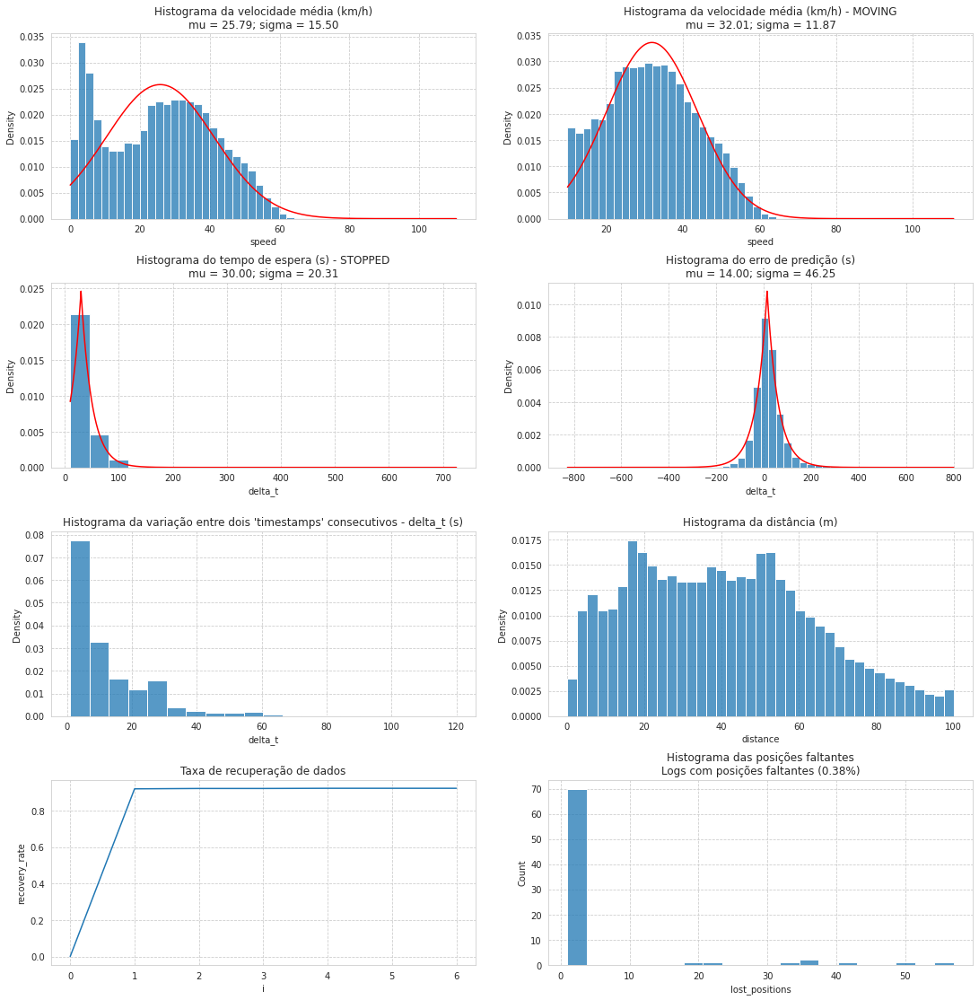

In [90]:
fig, axes = plt.subplots(nrows = 4, ncols = 2, figsize = (15, 15));
fig.tight_layout(h_pad = 5.0, w_pad = 5.0);
sns.set_style("whitegrid", {'grid.linestyle': '--'});

a = df2["speed"]
a = a[np.isfinite(a)]
sns.histplot(a, stat = "density", bins = 50, ax = axes[0, 0])
mu, sigma = norm.fit(a)
x_axis = np.arange(a.min(), a.max(), 0.01)
axes[0, 0].plot(x_axis, norm.pdf(x_axis, mu, sigma), color = "red")
axes[0, 0].set_title("Histograma da velocidade média (km/h)\nmu = {0:.2f}; sigma = {1:.2f}".format(mu, sigma));

a = df2.query("status == 'MOVING'")["speed"]
a = a[np.isfinite(a)]
sns.histplot(a, stat = "density", bins = 50, ax = axes[0, 1])
mu, sigma = norm.fit(a)
x_axis = np.arange(a.min(), a.max(), 0.01)
axes[0, 1].plot(x_axis, norm.pdf(x_axis, mu, sigma), color = "red")
axes[0, 1].set_title("Histograma da velocidade média (km/h) - MOVING\nmu = {0:.2f}; sigma = {1:.2f}".format(mu, sigma));

a = df4.query("last_status == 'MOVING' and status == 'STOPPED' and next_status == 'MOVING' and id == last_id and id == next_id and delta_t <= 900")["delta_t"]
a = a[np.isfinite(a)]
mu, sigma = laplace.fit(a)
sns.histplot(a, stat = "density", bins = 20, ax = axes[1, 0])
x_axis = np.arange(a.min(), a.max(), 0.01)
axes[1, 0].plot(x_axis, laplace.pdf(x_axis, mu, sigma), color = "red")
axes[1, 0].set_title("Histograma do tempo de espera (s) - STOPPED\nmu = {0:.2f}; sigma = {1:.2f}".format(mu, sigma));

a = df5.query("id == last_next_stop_id and last_estimated_next_eventtimestamp > last_event_timestamp and abs(delta_t) < 1000")["delta_t"]
a = a[np.isfinite(a)]
ax = sns.histplot(a, stat = "density", bins = 50, ax = axes[1, 1]);
mu, sigma = laplace.fit(a)
x_axis = np.arange(a.min(), a.max(), 0.01)
axes[1, 1].plot(x_axis, laplace.pdf(x_axis, mu, sigma), color = "red");
axes[1, 1].set_title("Histograma do erro de predição (s)\nmu = {0:.2f}; sigma = {1:.2f}".format(mu, sigma));

sns.histplot(df2["delta_t"], stat = "density", bins = 20, ax = axes[2, 0])
axes[2, 0].set_title("Histograma da variação entre dois 'timestamps' consecutivos - delta_t (s)");

a = aux.query("status == 'STOPPED' and distance <= 100")["distance"]
sns.histplot(a, stat = "density", ax = axes[2, 1])
axes[2, 1].set_title("Histograma da distância (m)");

sns.lineplot(data = df, x = "i", y = "recovery_rate", ax = axes[3, 0])
axes[3, 0].set_title("Taxa de recuperação de dados")

sns.histplot(df7.query("lost_positions > 0")["lost_positions"], stat = "count", bins = 20, ax = axes[3, 1])
axes[3, 1].set_title("Histograma das posições faltantes\nLogs com posições faltantes ({0:0.2f}%)".format(100 * p1 / len(df7)));

In [61]:
fig = px.scatter_mapbox(df3, lat = "latitude", lon = "longitude", color = 'line_code')
fig.update_layout(mapbox_style = "open-street-map")

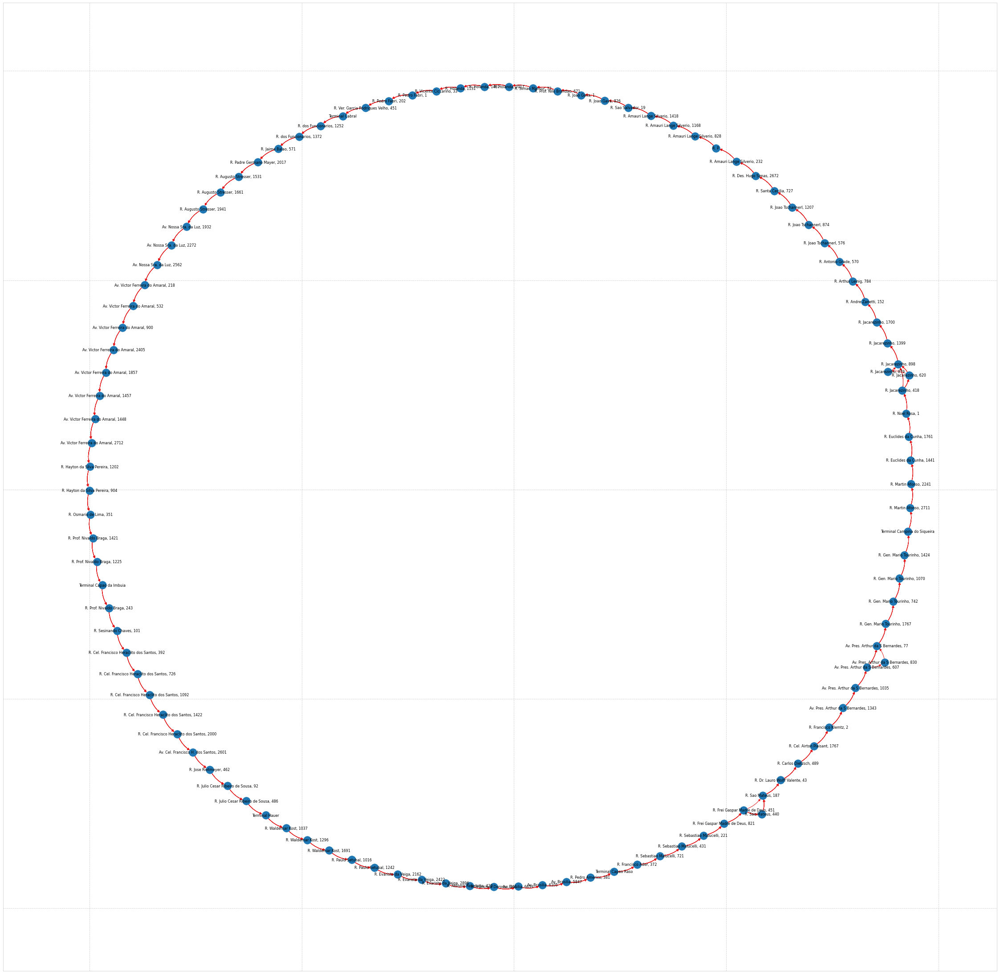

In [303]:
g = nx.MultiDiGraph()
for idx, node in df1[["id", "name_norm"]].drop_duplicates().iterrows():
    g.add_node(node["id"], **{"name": node["name_norm"]})
for idx, edge in df1[["line_code", "itinerary_id", "id", "name", "next_stop_id"]].drop_duplicates().iterrows():
    if edge["next_stop_id"] != None:
        g.add_edge(edge["id"], edge["next_stop_id"], **{"line_code": edge["line_code"], "itinerary_id": edge["itinerary_id"]})

fig = plt.figure(figsize = (40, 40))
pos = nx.kamada_kawai_layout(g)
node_labels = {}
for node in g.nodes.data():
    node_labels[node[0]] = node[1]["name"]

c = 0
colors = {}
g_aux = df1["line_code"].unique()
palette = sns.color_palette("Set1", len(g_aux))
for line_code in g_aux:
    colors[line_code] = palette[c]
    c += 1
    
edge_colors = []
for edge in g.edges.data():
    edge_colors.append(colors[edge[2]["line_code"]])
    
nx.draw_networkx(g, pos = pos, connectionstyle = "arc3, rad=0.2", labels = node_labels, edge_color = edge_colors, font_size = 8, with_labels = True)

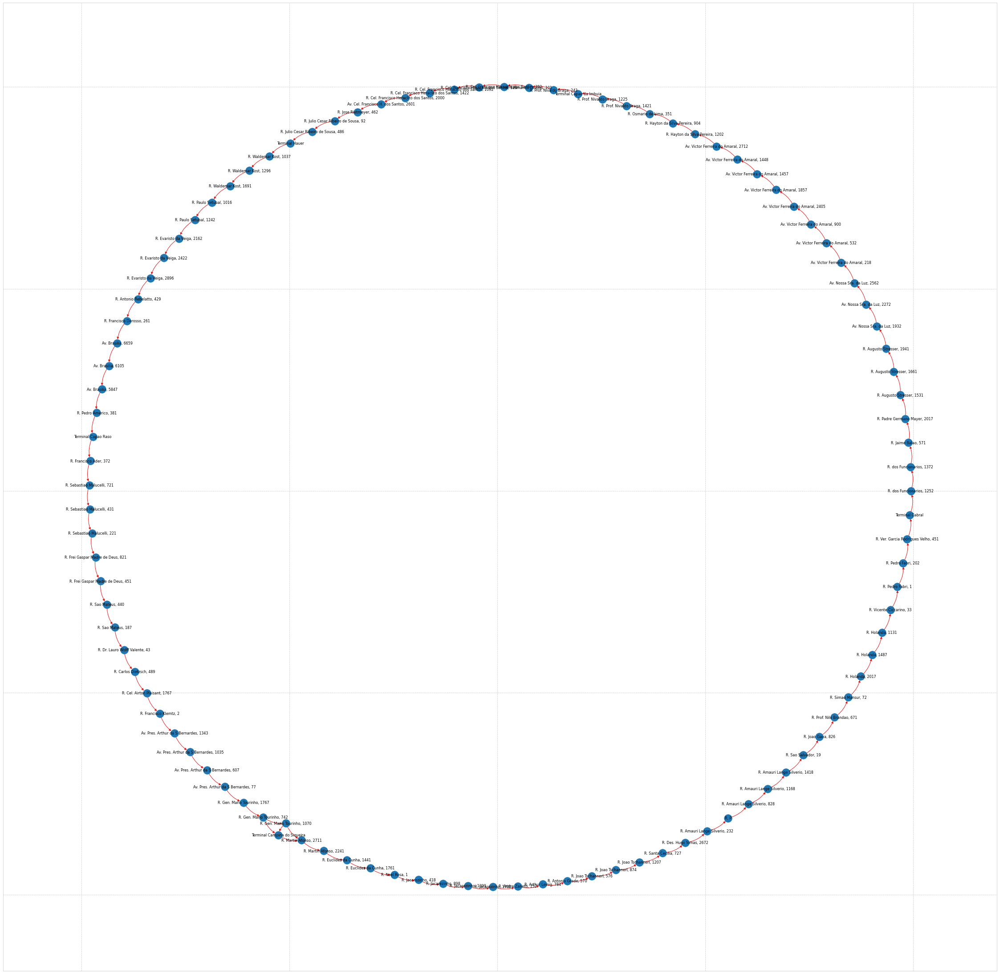

In [99]:
g = nx.MultiDiGraph()
df8 = df7.query("line_code == '020' and vehicle == 'EB607' and lost_positions == 0").sort_values(by = ["line_code", "vehicle", "event_timestamp"])
df8["next_stop_id"] = np.where((df8["line_code"] == df8["line_code"].shift(-1)) & (df8["vehicle"] == df8["vehicle"].shift(-1)), df8["id"].shift(-1), None)
for idx, node in df8[["id", "name_norm"]].drop_duplicates().iterrows():
    g.add_node(node["id"], **{"name": node["name_norm"]})
for idx, edge in df8[["line_code", "vehicle", "id", "next_stop_id"]].drop_duplicates().iterrows():
    if edge["next_stop_id"] != None and edge["id"] != edge["next_stop_id"]:
        g.add_edge(edge["id"], edge["next_stop_id"], **{"line_code": edge["line_code"], "vehicle": edge["vehicle"]})

fig = plt.figure(figsize = (40, 40))
pos = nx.kamada_kawai_layout(g)
node_labels = {}
for node in g.nodes.data():
    node_labels[node[0]] = node[1]["name"]

c = 0
colors = {}
g_aux = df8["line_code"].unique()
palette = sns.color_palette("Set1", len(g_aux))
for line_code in g_aux:
    colors[line_code] = palette[c]
    c += 1
    
edge_colors = []
for edge in g.edges.data():
    edge_colors.append(colors[edge[2]["line_code"]])
    
nx.draw_networkx(g, pos = pos, connectionstyle = "arc3, rad=0.2", labels = node_labels, edge_color = edge_colors, font_size = 8, with_labels = True)

In [64]:
df3.sort_values(by = ["line_code", "vehicle", "event_timestamp"]).to_csv("df3.csv")

In [97]:
df7.sort_values(by = ["line_code", "vehicle", "event_timestamp"]).to_csv("df7.csv")